In [ ]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))
#         break

# # You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# # You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

## Import All Libraries

In [31]:
import warnings
warnings.filterwarnings('ignore')

import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.metrics import classification_report , confusion_matrix , accuracy_score , auc
from sklearn.model_selection import train_test_split

import cv2
#from google.colab.patches import cv2_imshow
from PIL import Image 
'''import tensorflow as tf
from tensorflow import keras
from keras import Sequential
from keras.layers import Input, Dense,Conv2D , MaxPooling2D, Flatten,BatchNormalization,Dropout
from tensorflow.keras.preprocessing import image_dataset_from_directory
import tensorflow_hub as hub 

from keras.applications.vgg19 import VGG19'''

'import tensorflow as tf\nfrom tensorflow import keras\nfrom keras import Sequential\nfrom keras.layers import Input, Dense,Conv2D , MaxPooling2D, Flatten,BatchNormalization,Dropout\nfrom tensorflow.keras.preprocessing import image_dataset_from_directory\nimport tensorflow_hub as hub \n\nfrom keras.applications.vgg19 import VGG19'

In [32]:
train_csv_path = "/kaggle/input/UBC-OCEAN/train.csv"
test_csv_path = "/kaggle/input/UBC-OCEAN/test.csv"

train_df = pd.read_csv(train_csv_path)
train_df

,image_id,label,image_width,image_height,is_tma
0,4,HGSC,23785,20008,False
1,66,LGSC,48871,48195,False
2,91,HGSC,3388,3388,True
3,281,LGSC,42309,15545,False
4,286,EC,37204,30020,False
...,...,...,...,...,...
533,65022,LGSC,53355,46675,False
534,65094,MC,55042,45080,False
535,65300,HGSC,75860,27503,False
536,65371,HGSC,42551,41800,False


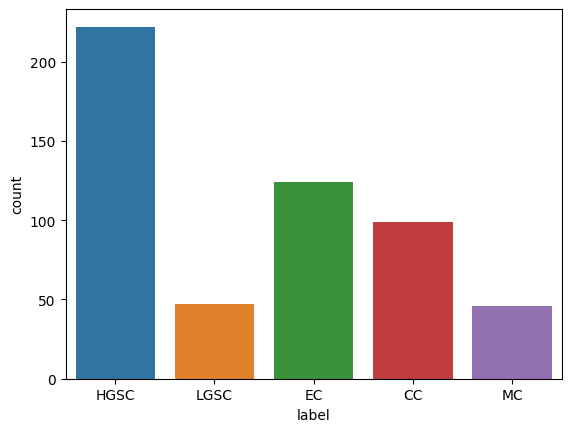

In [5]:
sns.countplot(x=train_df['label'])
plt.show()

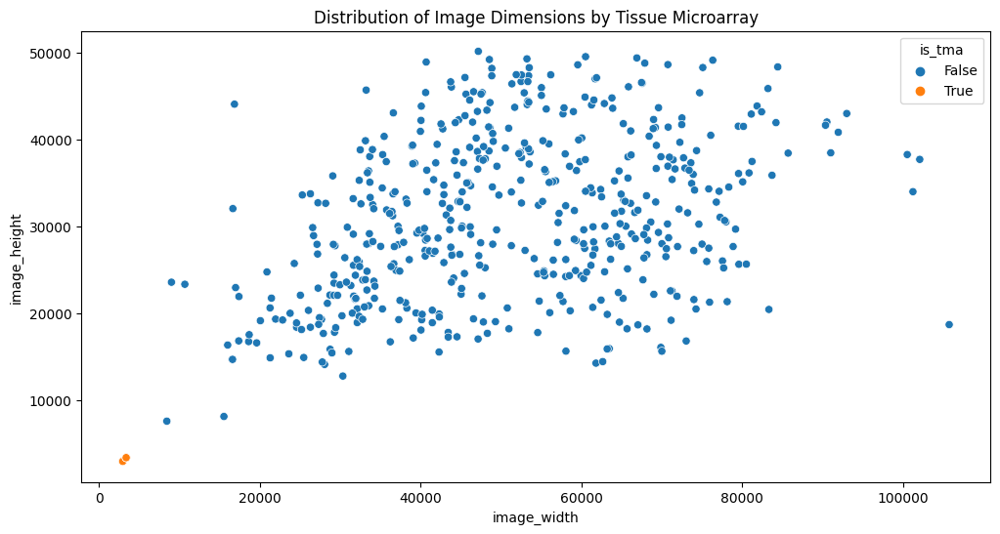

In [4]:
plt.figure(figsize=(12, 6))
sns.scatterplot(x="image_width", y="image_height", hue="is_tma", data=train_df)
plt.title("Distribution of Image Dimensions by Tissue Microarray")
plt.show()

In [33]:
train_df['is_tma'] = train_df['is_tma'].astype('int8')

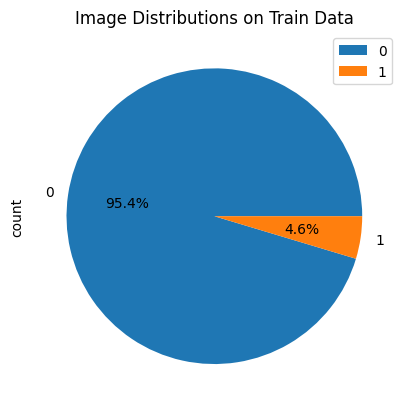

In [6]:
train_df['is_tma'].value_counts().plot(kind="pie",autopct="%.1f%%")
plt.title("Image Distributions on Train Data")
plt.legend()
plt.show()

In [34]:
train_thumbnails = os.listdir("/kaggle/input/UBC-OCEAN/train_thumbnails")
train_images = os.listdir("/kaggle/input/UBC-OCEAN/train_images")

In [35]:
class_labels = ['HGSC','LGSC','EC','CC','MC']
train_df['label'] = train_df['label'].replace({'HGSC':0, 'LGSC':1, 'EC':2, 'CC':3, 'MC':4})
train_df.head()

,image_id,label,image_width,image_height,is_tma
0,4,0,23785,20008,0
1,66,1,48871,48195,0
2,91,0,3388,3388,1
3,281,1,42309,15545,0
4,286,2,37204,30020,0


In [36]:
train_df['image_id']=train_df['image_id'].astype("int32")
train_df['label']=train_df['label'].astype("int8")
train_df['image_width']=train_df['image_width'].astype("int32")
train_df['image_height']=train_df['image_height'].astype("int32")

In [8]:
#train_df['label'].value_counts()
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 538 entries, 0 to 537
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   image_id      538 non-null    int32
 1   label         538 non-null    int8 
 2   image_width   538 non-null    int32
 3   image_height  538 non-null    int32
 4   is_tma        538 non-null    int8 
dtypes: int32(3), int8(2)
memory usage: 7.5 KB


In [9]:
train_df.head()

,image_id,label,image_width,image_height,is_tma
0,4,0,23785,20008,0
1,66,1,48871,48195,0
2,91,0,3388,3388,1
3,281,1,42309,15545,0
4,286,2,37204,30020,0


## Patch extraction

In [37]:
Image.MAX_IMAGE_PIXELS = 10000000000
# Define patch size and overlap (if needed)  
patch_size = (512,512)# 提取图块大小 Adjust this according to your requirements
patch_size_TMA = (1024,1024)
overlap = 20  # 相邻图块之间的重叠 Adjust this if you want overlapping patches
resize_size = (256, 256)  # New size for the resized image

image_data = []
image_label = []
img_ids=[] #imageid方便后面majority voting
empty_img=0
for img_id, label , tma in zip(train_df['image_id'],train_df['label'], train_df['is_tma']):
    #print(img_id, label,  tma)
    if tma==0:
        img_name = str(img_id)+"_thumbnail.png"
        large_image = Image.open("/kaggle/input/UBC-OCEAN/train_thumbnails/"+img_name)
        for y in range(0, large_image.height, patch_size[0] - overlap): # (0,2523,192)
            for x in range(0, large_image.width, patch_size[1] - overlap):  # (0,3000,192)  224-32=192
                patch = large_image.crop((x, y, x+patch_size[1], y+patch_size[0]))
                resized_patch = patch.resize(resize_size)
                image = np.array(resized_patch)
                #image = np.array(patch)
                if np.sum(image)==0:
                    empty_img+=1
                elif (np.sum(image[0:,0:50])==0) or (np.sum(image[0:,50:])==0) or (np.sum(image[0:,100:])==0):
                    empty_img+=1
                elif (np.sum(image[0:50,0:])==0) or (np.sum(image[50:,0:])==0) or (np.sum(image[100:,0:])==0):
                    empty_img+=1
                elif (np.sum(image[0:50,0:50])==0) or (np.sum(image[0:50,50:])==0):
                    empty_img+=1
                elif (np.sum(image[50:100,0:50])==0) or (np.sum(image[50:100,50:])==0):
                    empty_img+=1
                elif (np.sum(image[50:,0:100])==0) or (np.sum(image[80:,80:])==0):
                    empty_img+=1
                elif (np.sum(image[0:50,75:])==0) or (np.sum(image[50:,75:])==0):
                    empty_img+=1
                elif (np.sum(image[0:40,80:])==0) or (np.sum(image[80:,80:])==0):
                    empty_img+=1
                elif (np.sum(image[0:35,0:])==0) or (np.sum(image[80:,0:])==0):
                    empty_img+=1
                elif (np.sum(image[0:25,0:50])==0) or (np.sum(image[0:25,100:])==0):
                    empty_img+=1
                elif (np.sum(image[0:20,0:25])==0) or (np.sum(image[0:20,25:50])==0) or (np.sum(image[0:20,50:80])==0) or (np.sum(image[0:20,90:])==0):
                    empty_img+=1
                elif (np.sum(image[0:25,0:25])==0) or (np.sum(image[0:25,100:])==0) or (np.sum(image[100:,0:25])==0) or (np.sum(image[100:,100:])==0):
                    empty_img+=1
                elif (np.sum(image[0:15,0:])==0) or (np.sum(image[115:,0:])==0):
                    empty_img+=1
                elif (np.sum(image[0:,0:15])==0) or (np.sum(image[0:,115:])==0):
                    empty_img+=1
                elif (np.sum(image[0:20,0:20])==0) or (np.sum(image[0:20,110:])==0) or (np.sum(image[110:,0:20])==0) or (np.sum(image[110:,110:])==0):
                    empty_img+=1
                elif (np.sum(image[0:10,0:10])==0) or (np.sum(image[0:10,115:])==0) or (np.sum(image[0:10,40:60])==0) or (np.sum(image[0:10,80:100])==0):
                    empty_img+=1
                elif (np.sum(image[40:50,0:10])==0) or (np.sum(image[110:,80:100])==0) or (np.sum(image[70:85,70:90])==0) or (np.sum(image[50:60,110:])==0):
                    empty_img+=1

                else:
                    image_data.append(image)
                    image_label.append(label)
                    img_ids.append(img_id)
    elif tma==1:
        img_name = str(img_id)+".png"
        large_image = Image.open("/kaggle/input/UBC-OCEAN/train_images/"+img_name)
        for y in range(0, large_image.height, patch_size_TMA[0] - overlap):   #patchsize都改成了patch_size_TMA
            for x in range(0, large_image.width, patch_size_TMA[1] - overlap):   #patch_size都改成了patch_size_TMA
                fortypatch = large_image.crop((x, y, x+patch_size_TMA[1], y+patch_size_TMA[0]))  #patchsize都改成了patch_size_TMA，引入了fortypatch和twentypatch
                twentypatch = fortypatch.resize(patch_size, Image.LANCZOS)  #新加的，用 Lancoz filter 把40倍放大的1024转换成 20倍放大的512
                resized_patch = twentypatch.resize(resize_size) 
                image = np.array(resized_patch)
                #image = np.array(patch)
                if np.sum(image)==0:
                    empty_img+=1
                elif (np.sum(image[0:,0:50])==0) or (np.sum(image[0:,50:])==0) or (np.sum(image[0:,100:])==0):
                    empty_img+=1
                elif (np.sum(image[0:50,0:])==0) or (np.sum(image[50:,0:])==0) or (np.sum(image[100:,0:])==0):
                    empty_img+=1
                elif (np.sum(image[0:50,0:50])==0) or (np.sum(image[0:50,50:])==0):
                    empty_img+=1
                elif (np.sum(image[50:100,0:50])==0) or (np.sum(image[50:100,50:])==0):
                    empty_img+=1
                elif (np.sum(image[50:,0:100])==0) or (np.sum(image[80:,80:])==0):
                    empty_img+=1
                elif (np.sum(image[0:50,75:])==0) or (np.sum(image[50:,75:])==0):
                    empty_img+=1
                elif (np.sum(image[0:40,80:])==0) or (np.sum(image[80:,80:])==0):
                    empty_img+=1
                elif (np.sum(image[0:35,0:])==0) or (np.sum(image[80:,0:])==0):
                    empty_img+=1
                elif (np.sum(image[0:25,0:50])==0) or (np.sum(image[0:25,100:])==0):
                    empty_img+=1
                elif (np.sum(image[0:20,0:25])==0) or (np.sum(image[0:20,25:50])==0) or (np.sum(image[0:20,50:80])==0) or (np.sum(image[0:20,90:])==0):
                    empty_img+=1
                elif (np.sum(image[0:25,0:25])==0) or (np.sum(image[0:25,100:])==0) or (np.sum(image[100:,0:25])==0) or (np.sum(image[100:,100:])==0):
                    empty_img+=1
                elif (np.sum(image[0:15,0:])==0) or (np.sum(image[115:,0:])==0):
                    empty_img+=1
                elif (np.sum(image[0:,0:15])==0) or (np.sum(image[0:,115:])==0):
                    empty_img+=1
                elif (np.sum(image[0:20,0:20])==0) or (np.sum(image[0:20,110:])==0) or (np.sum(image[110:,0:20])==0) or (np.sum(image[110:,110:])==0):
                    empty_img+=1
                elif (np.sum(image[0:10,0:10])==0) or (np.sum(image[0:10,115:])==0) or (np.sum(image[0:10,40:60])==0) or (np.sum(image[0:10,80:100])==0):
                    empty_img+=1
                elif (np.sum(image[40:50,0:10])==0) or (np.sum(image[110:,80:100])==0) or (np.sum(image[70:85,70:90])==0) or (np.sum(image[50:60,110:])==0):
                    empty_img+=1
                
                    
                else:
                    image_data.append(image)
                    image_label.append(label)
                    img_ids.append(img_id)

print(len(image_data))
print(len(image_label))
print(len(img_ids))
print(empty_img)

5522
5522
5522
11293


In [38]:
image_data[0].shape

(256, 256, 3)

## Training Images Visualization

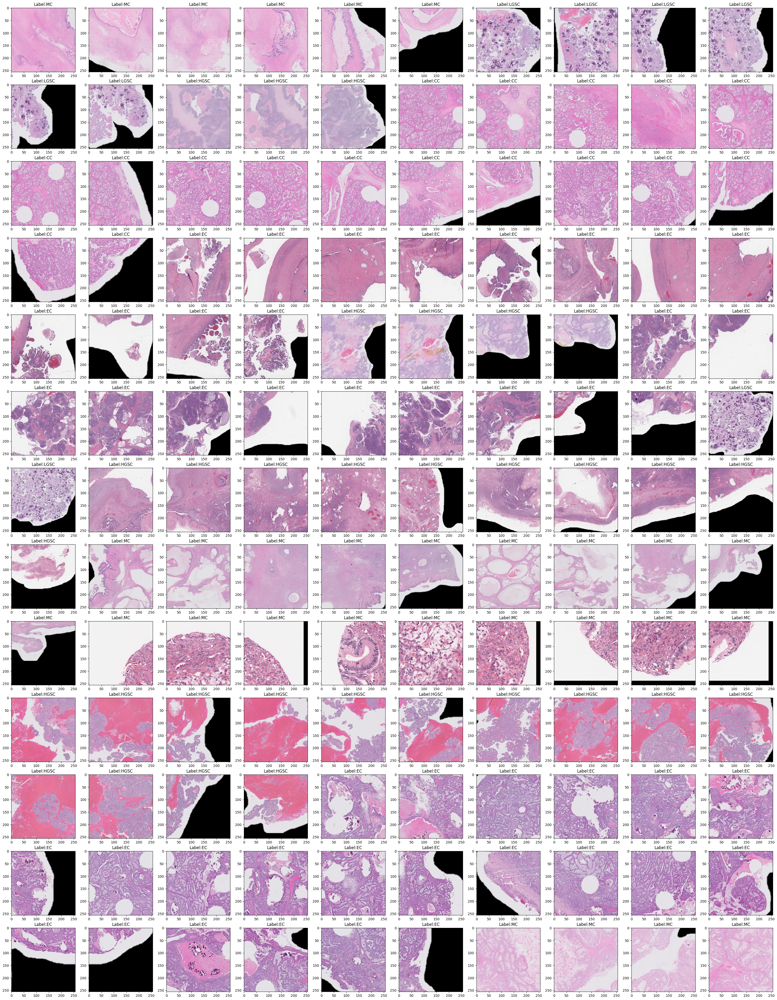

In [27]:
plt.figure(figsize=(40,60))
j=1
#for i in range(0,50):
for i in range(250,380):
    plt.subplot(15,10,j)
    plt.imshow(image_data[i])
    plt.title(f"Label:{class_labels[image_label[i]]}")
    #plt.title(f"IMAGE_ID:{img_ids[i]}")
    j+=1

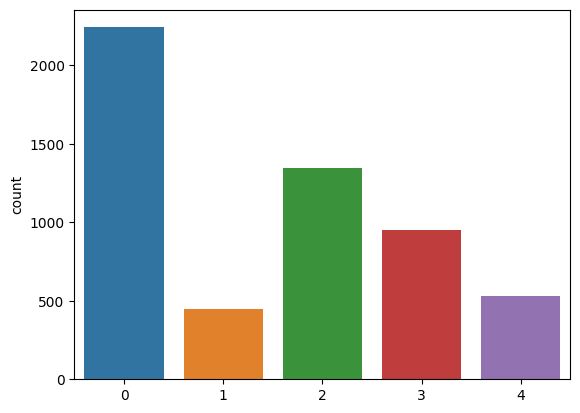

In [39]:
ax=sns.countplot(x=image_label) 
plt.show()

# Filter

In [40]:
# 计算每个图像块的像素之和
sums = [np.sum(patch) for patch in image_data]

# 将图像块、标签和图像 ID 组合成一个列表
data_and_labels = list(zip(image_data, image_label, img_ids, sums))

# 按像素之和对列表进行排序
sorted_data_and_labels = sorted(data_and_labels, key=lambda x: x[3])

# 选择排序后的前 4700 个元素
selected_data_and_labels = sorted_data_and_labels[:4700]

# 分离选定的数据、标签和图像 ID
selected_image_data, selected_labels, selected_img_ids, _ = zip(*selected_data_and_labels)

# 输出选定子集的大小
print(len(selected_image_data))

# 现在，selected_image_data、selected_labels 和 selected_img_ids 分别包含了你所需的子集的图像、标签和图像 ID。


4700


In [41]:
slct_image_data = list(selected_image_data)
slct_labels = list(selected_labels)
slct_img_ids = list(selected_img_ids)

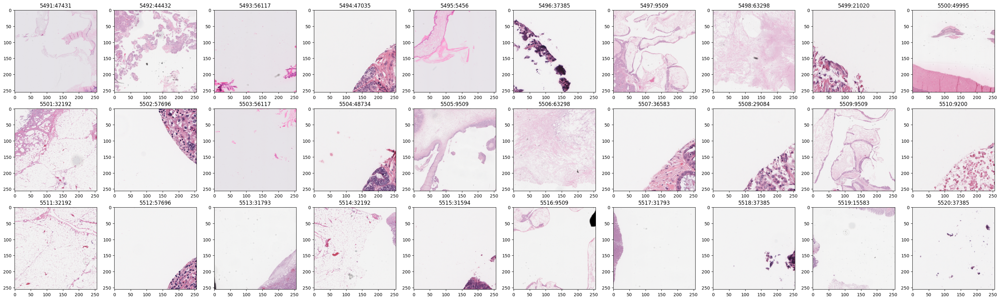

In [17]:
plt.figure(figsize=(40,60))
j=1
for i in range(5491,5521):
#for i in range(250,380):
    plt.subplot(15,10,j)
    plt.imshow(sorted_data_and_labels[i][0])
    plt.title(f"{i}:{sorted_data_and_labels[i][2]}")
    j+=1

# Rotation
两个用：1.放大datasize 2.让label更平均，不出现提取特征时的bias

In [42]:
#Rotation
import random
random.seed(42) 
for i in range(len(slct_image_data)):
    img = Image.fromarray(slct_image_data[i])  # 将图像数组转换为 PIL Image 对象

    label =slct_labels[i]
    img_id=slct_img_ids[i]

    if label in [1, 3, 4]:
        rotated_img = img.rotate(90)
        slct_image_data.append(np.array(rotated_img))
        slct_labels.append(label)
        slct_img_ids.append(img_id)
    elif label == 2:
        if random.random() < 0.5:
            rotated_img = img.rotate(90)
            slct_image_data.append(np.array(rotated_img))
            slct_labels.append(label)
            slct_img_ids.append(img_id)

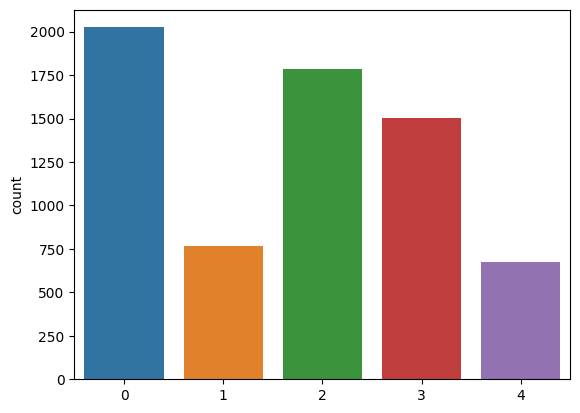

In [43]:
sns.countplot(x=slct_labels)
plt.show()

In [44]:
print(len(slct_image_data))
print(len(slct_labels))
print(len(slct_img_ids))

6758
6758
6758


In [24]:
set(slct_labels)

{0, 1, 2, 3, 4}

# Stain Normalization

In [30]:
img_ids[305]

3511

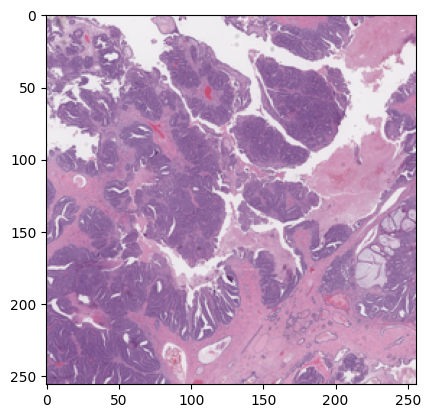

In [26]:
plt.imshow(slct_image_data[1269]) #因为图片数量变了，target的编号也变了

In [ ]:
#import joblib
#joblib.dump(image_data[345], 'target.joblib')

In [45]:
!pip install torchstain

In [46]:
import cv2
import matplotlib.pyplot as plt
import torchstain
import torch
from torchvision import transforms
import time

transformed_image = []
target = slct_image_data[1269]
for i in range(0, len(slct_image_data)):
    #print(i)
    to_transform = cv2.cvtColor(slct_image_data[i], cv2.COLOR_BGR2RGB)

    T = transforms.Compose([
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x * 255)
    ])

    normalizer = torchstain.normalizers.MacenkoNormalizer(backend='torch')

    try:
        normalizer.fit(T(target))
        t_to_transform = T(to_transform)
        norm, H, E = normalizer.normalize(I=t_to_transform, stains=True)
        transformed_image.append(norm)
    except (IndexError, torch.linalg.LinAlgError) as e:
        print(f"Error processing image at index {i}: {e}")
        # If an error occurs, append the original image
        transformed_image.append(to_transform)
        
'''@software{barbano2022torchstain,
  author       = {Carlo Alberto Barbano and
                  André Pedersen},
  title        = {EIDOSLAB/torchstain: v1.2.0-stable},
  month        = aug,
  year         = 2022,
  publisher    = {Zenodo},
  version      = {v1.2.0-stable},
  doi          = {10.5281/zenodo.6979540},
  url          = {https://doi.org/10.5281/zenodo.6979540}
}
@inproceedings{barbano2021unitopatho,
  title={UniToPatho, a labeled histopathological dataset for colorectal polyps classification and adenoma dysplasia grading},
  author={Barbano, Carlo Alberto and Perlo, Daniele and Tartaglione, Enzo and Fiandrotti, Attilio and Bertero, Luca and Cassoni, Paola and Grangetto, Marco},
  booktitle={2021 IEEE International Conference on Image Processing (ICIP)},
  pages={76--80},
  year={2021},
  organization={IEEE}
}'''

Error processing image at index 3222: kthvalue(): Expected reduction dim 0 to have non-zero size.
Error processing image at index 6011: kthvalue(): Expected reduction dim 0 to have non-zero size.


'@software{barbano2022torchstain,\n  author       = {Carlo Alberto Barbano and\n                  André Pedersen},\n  title        = {EIDOSLAB/torchstain: v1.2.0-stable},\n  month        = aug,\n  year         = 2022,\n  publisher    = {Zenodo},\n  version      = {v1.2.0-stable},\n  doi          = {10.5281/zenodo.6979540},\n  url          = {https://doi.org/10.5281/zenodo.6979540}\n}\n@inproceedings{barbano2021unitopatho,\n  title={UniToPatho, a labeled histopathological dataset for colorectal polyps classification and adenoma dysplasia grading},\n  author={Barbano, Carlo Alberto and Perlo, Daniele and Tartaglione, Enzo and Fiandrotti, Attilio and Bertero, Luca and Cassoni, Paola and Grangetto, Marco},\n  booktitle={2021 IEEE International Conference on Image Processing (ICIP)},\n  pages={76--80},\n  year={2021},\n  organization={IEEE}\n}'

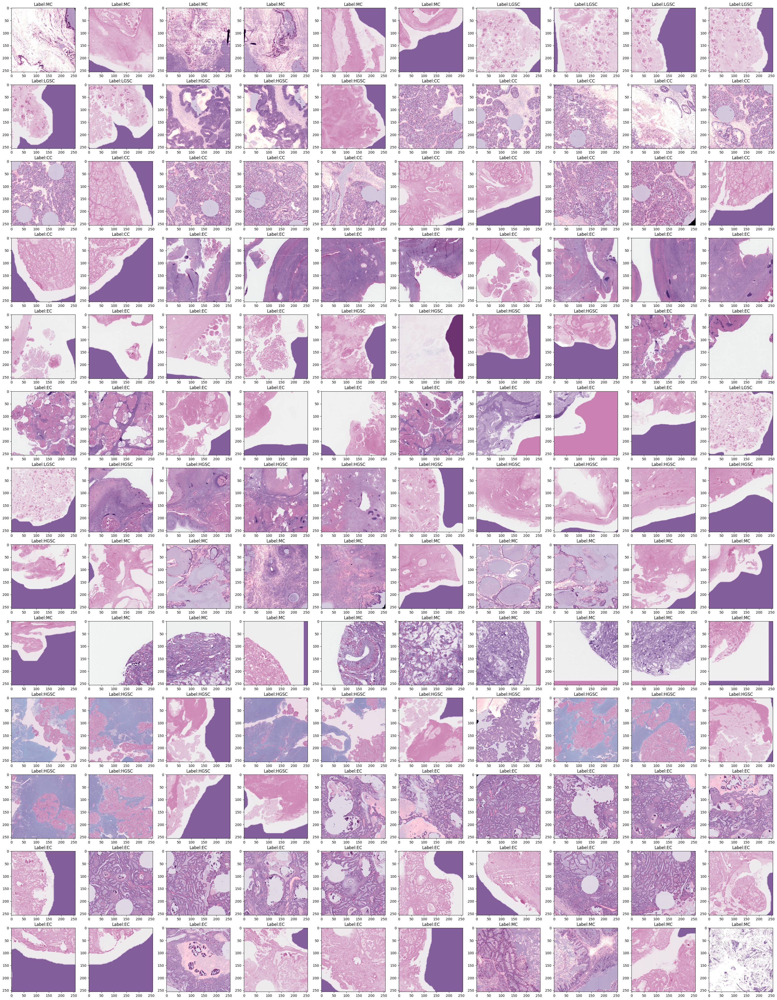

In [25]:
plt.figure(figsize=(40,60))
j=1
#for i in range(500,650):
for i in range(250,380):
    plt.subplot(15,10,j)
    plt.imshow(transformed_image[i])
    plt.title(f"Label:{class_labels[image_label[i]]}")
    j+=1

In [47]:
print(len(transformed_image))

6758


# Scale 
All patches were normalized to RGB pixel values between -1 and 1 based on the ImageNet mean and standard deviation

In [48]:
normalized_image=[]
for i in range(0,len(transformed_image) ):
    
    # Your image data
    image = np.array(transformed_image[i])  # convert torch.Size([256, 256, 3]) to np array

    # Define ImageNet mean and standard deviation values for each channel
    imagenet_mean = np.array([0.485, 0.456, 0.406])
    imagenet_std = np.array([0.229, 0.224, 0.225])

    # Step 1: Convert to float16
    image_data_float = image.astype(np.float16)

    # Step 2: Normalize to [0, 1]
    image_data_normalized2 = image_data_float / 255.0

    # Step 3: Subtract mean
    image_data_normalized2 -= imagenet_mean

    # Step 4: Divide by standard deviation
    image_data_normalized2 /= imagenet_std

    # Clip values to be within the range [-1, 1]
    image_data_normalized2 = np.clip(image_data_normalized2, -1, 1)
    normalized_image.append(image_data_normalized2)

In [49]:
print(len(normalized_image))

6758


In [50]:
print(normalized_image[i].shape)
print(normalized_image[i].dtype)

(256, 256, 3)
float16


In [51]:
print(len(normalized_image))
print(len(slct_labels))
print(len(slct_img_ids))

6758
6758
6758


In [52]:
import joblib

# Assuming normalized_image, slct_labels, and slct_img_ids are your data
# You can modify the paths and filenames according to your preferences

# Create a directory to store the data
output_directory = "/kaggle/working/"
#os.makedirs(output_directory, exist_ok=True)

# Save normalized_image
normalized_image_path = os.path.join(output_directory, "normalized_images.joblib")
joblib.dump(normalized_image, normalized_image_path)

# Save slct_labels
slct_labels_path = os.path.join(output_directory, "selected_labels.joblib")
joblib.dump(slct_labels, slct_labels_path)

# Save slct_img_ids
slct_img_ids_path = os.path.join(output_directory, "selected_image_ids.joblib")
joblib.dump(slct_img_ids, slct_img_ids_path)

['/kaggle/working/selected_image_ids.joblib']

哈哈，完活儿了